<a href="https://colab.research.google.com/github/vaani787/Lane.detection/blob/main/way_1_updated.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import numpy as np
import cv2
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
import os
import time

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
!cp -r /content/drive/MyDrive/kitti_dataset /content

In [4]:
files = ["/content/drive/MyDrive/kitti_dataset/complete/" + i for i in os.listdir("/content/drive/MyDrive/kitti_dataset/complete")]

In [5]:
files[0]

'/content/drive/MyDrive/kitti_dataset/complete/0000000024.png'

In [6]:
img = cv2.imread("f.png")

#**Function to Draw Images**


In [7]:
def draw_imgs(lst, rows = 3, cols=2, figsize=(24, 9)):
    fig = plt.figure(figsize=figsize)
    fig.tight_layout()
    for i in range(1, rows * cols +1):
        fig.add_subplot(rows, cols, i)
        img = mpimg.imread(lst[i-1])
        plt.imshow(img)


**Workflow 1**


1. Undistortion
2. Gray scaling
3. Gaussian
4. Binary Thresholding
5. Canny
6. Hough


#**Plot original and modified image**

In [8]:
def plot_images(original, modified, title1, title2):
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(cv2.cvtColor(original, cv2.COLOR_BGR2RGB))
    ax1.set_title(title1, fontsize=50)
    ax2.imshow(cv2.cvtColor(modified, cv2.COLOR_BGR2RGB), cmap='gray')
    ax2.set_title(title2, fontsize=50)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

#**Undistortion**

In [9]:
def undistort(img):
    #img = cv2.imread(img_name)
    mtx = np.array([[9.597910e+02,0.000000e+00,6.960217e+02],[0.000000e+00,9.569251e+02,2.241806e+02],[0.000000e+00,0.000000e+00,1.000000e+00]])
    dist = np.array([[-3.691481e-01,1.968681e-01,1.353473e-03,5.677587e-04,-6.770705e-02]])
    undist= cv2.undistort(img, mtx, dist, None, mtx)
    return undist

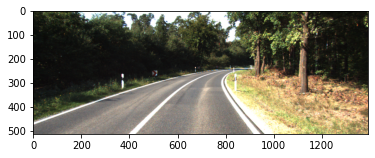

In [11]:
img=cv2.imread(files[1])
undistorted_img=undistort(img)# Undistorted
plt.imshow(cv2.cvtColor(undistorted_img, cv2.COLOR_BGR2RGB))

#**Region Of Interest**

In [12]:
def region_of_interest():
  b_l=(397,503)
  b_r=(965,503)
  t_r=(751,265)
  t_l=(637,265)
  points = [b_l,b_r,t_r,t_l]  

  return points

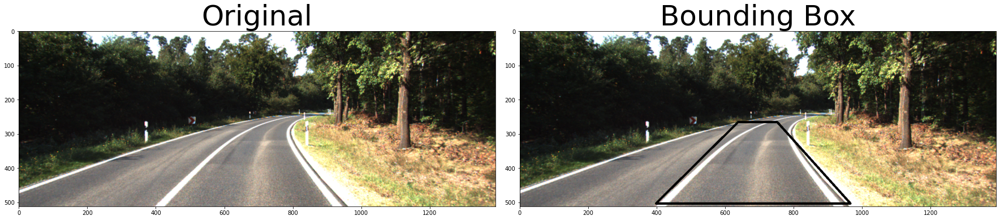

In [13]:
img = undistorted_img.copy()
points=region_of_interest()
cv2.line(img, points[0], points[1], 0, 5)
cv2.line(img, points[1], points[2], 0, 5)
cv2.line(img, points[2], points[3], 0, 5)
cv2.line(img, points[3], points[0], 0, 5)

plot_images(undistorted_img, img, "Original", "Bounding Box")

#**Preprocessing**

In [14]:
def preprocess(img):
  grayImage = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  blur = cv2.GaussianBlur(grayImage,(5,5),0)
  (thresh, bnwImage) = cv2.threshold(blur,200, 255, cv2.THRESH_BINARY)
  canny = cv2.Canny(bnwImage,50,150)
#   cv2.imwrite("gray.jpg",grayImage)
#   cv2.imwrite("blur.jpg",blur)
  cv2.imwrite("binary_thesh.jpg",(bnwImage*255).astype("uint8"))
#   cv2.imwrite("canny.jpg",(canny*255).astype("uint8"))
  return canny

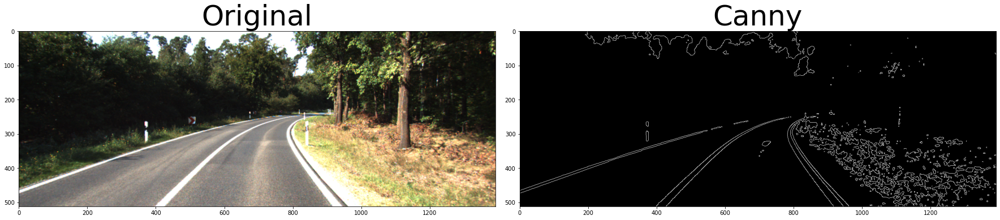

In [15]:
canny=preprocess(undistorted_img)

plot_images(undistorted_img,canny,'Original','Canny')

#**Bounding box masking**

In [16]:
def bounding_box_masking(points,img):
  points1 = np.array([points])
  mask = np.zeros_like(canny)
  cv2.fillPoly(mask, points1,255)
  segment = cv2.bitwise_and(canny, mask)

  return segment

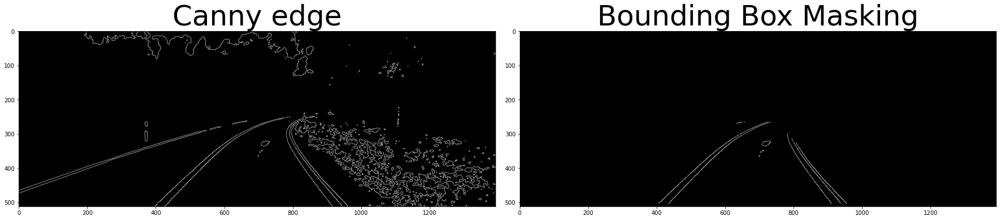

In [17]:
segment=bounding_box_masking(points,canny)
plot_images(canny, segment,'Canny edge', "Bounding Box Masking")

#**Hough transform**

In [18]:
def display_lines(image,lines):
    line_image = np.zeros_like(image)
    for line in lines:
        x1,y1,x2,y2 = line.reshape(4)
        cv2.line(line_image,(x1,y1),(x2,y2),(31,0,255),6)
    return line_image

In [19]:
def hough_lines(img,minLineLength,maxLineGap):
  lines = cv2.HoughLinesP(img, 2, np.pi / 180, 0, np.array([]), minLineLength, maxLineGap)
  return lines

[[[404 503 549 368]]

 [[435 503 561 372]]

 [[809 366 908 502]]

 [[781 303 888 435]]

 [[819 381 897 488]]]


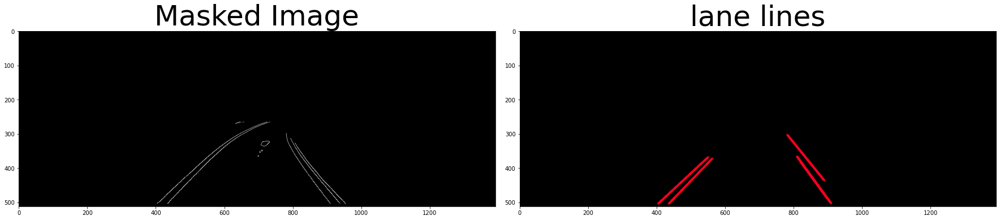

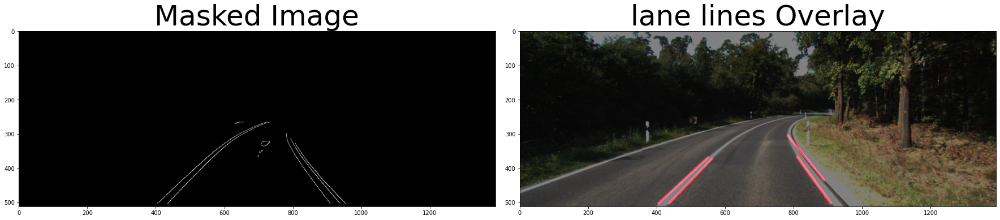

In [20]:
lines = hough_lines(segment,100,30)
print(lines)
line_image = display_lines(undistorted_img,lines)
overlay_img = cv2.addWeighted(undistorted_img,0.5,line_image,1,1)

plot_images(segment,line_image,'Masked Image','lane lines')
plot_images(segment,overlay_img,'Masked Image','lane lines Overlay')

#**Separating left and right lanes**

In [21]:
def left_and_right(points,lines):
  bottom_mid=(points[0][0]+points[1][0])/2
  top_mid=(points[3][0]+points[2][0])/2
  mid_pt=(top_mid+bottom_mid)/2
  
  right_lane=[]
  left_lane=[]
  for i in lines:
    
      if (i[0][0]>687.5 and i[0][2]>687.5 ):
          right_lane.append(i[0])
      else:
          left_lane.append(i[0])   
  right_lane=np.array(right_lane)
  left_lane=np.array(left_lane)

  return right_lane, left_lane

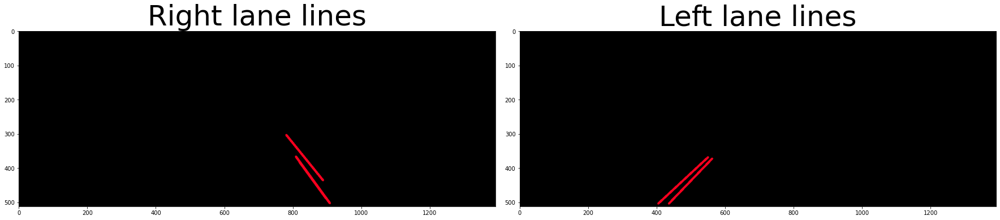

In [22]:
right_lane,left_lane=left_and_right(points,lines)
right_line_image = display_lines(undistorted_img,right_lane)
left_line_image = display_lines(undistorted_img,left_lane)
plot_images(right_line_image,left_line_image,'Right lane lines','Left lane lines')

#**Finding best fitting lane lines**

In [23]:

def fitting_polynomial(x,y,n):
  fit=np.polyfit(x,y,2)
  a=fit[0]
  b=fit[1]
  c=fit[2]
  return a,b,c

In [24]:
def best_fitting(left = False):

  if not left :
    x_right=[]
    y_right=[]
    for i in right_lane:
        x_right.append(i[0])
        x_right.append(i[2])
      
        y_right.append(i[1])
        y_right.append(i[3])  

    x_right=np.array(x_right)
    x_sorted_right=np.sort(x_right)
    y_right=np.array(y_right)
    a1,b1,c1=fitting_polynomial(x_right,y_right,2)
    fit_equation_right = a1 * np.square(x_sorted_right) + b1 * x_sorted_right + c1

    return x_right,y_right,x_sorted_right,fit_equation_right
 
  else :
    x_left=[]
    y_left=[]
    for i in left_lane:
        x_left.append(i[0])
        x_left.append(i[2])
        
        y_left.append(i[1])
        y_left.append(i[3])

    x_left=np.array(x_left)
    x_sorted_left=np.sort(x_left)
    y_left=np.array(y_left)
    a2,b2,c2=fitting_polynomial(x_left,y_left,2)
    fit_equation_left = a2 * np.square(x_sorted_left) + b2 * x_sorted_left + c2

    return x_left,y_left,x_sorted_left,fit_equation_left
  


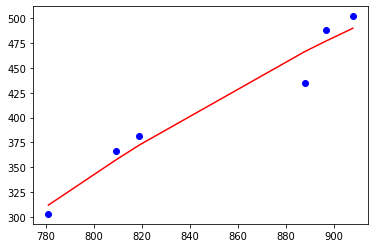

In [25]:
x_right,y_right,x_sorted_right,fit_equation_right=best_fitting(left=False)
plt.scatter(x_right,y_right,color='b',label='Data points')
plt.plot(x_sorted_right,fit_equation_right,color='r')

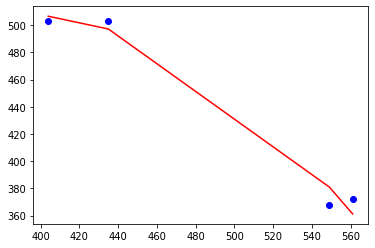

In [26]:
x_left,y_left,x_sorted_left,fit_equation_left=best_fitting(left=True)
plt.scatter(x_left,y_left,color='b',label='Data points')
plt.plot(x_sorted_left,fit_equation_left,color='r')

In [27]:
def final_lane_line(left=False):
  
  if not left:
    a1,b1,c1=fitting_polynomial(x_right,y_right,2)
    right_lane_single=[]
    right_lane_single.extend([x_sorted_right[-1],int(a1*np.square(x_sorted_right[-1])+b1*x_sorted_right[-1]+c1)])
    right_lane_single.append(x_sorted_right[0])
    right_lane_single.append(int(a1*np.square(x_sorted_right[0])+b1*x_sorted_right[0]+c1))
    right_lane_single=np.array([right_lane_single])
    return right_lane_single


  else:
    a2,b2,c2=fitting_polynomial(x_left,y_left,2)
    left_lane_single=[]
    left_lane_single.extend([x_sorted_left[-1],int(a2*np.square(x_sorted_left[-1])+b2*x_sorted_left[-1]+c2)])
    left_lane_single.append(x_sorted_left[0])
    left_lane_single.append(int(a2*np.square(x_sorted_left[0])+b2*x_sorted_left[0]+c2))
    left_lane_single=np.array([left_lane_single])
    return left_lane_single
    

[[908 489 781 311]]


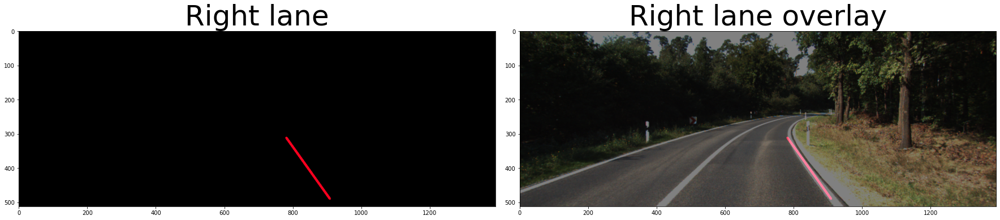

In [28]:
right_lane_single=final_lane_line(left=False)
print(right_lane_single)
final_right_lane=display_lines(undistorted_img,right_lane_single)

overlay_right = cv2.addWeighted(undistorted_img,0.5,final_right_lane,1,1)
plot_images(final_right_lane,overlay_right,'Right lane','Right lane overlay')

[[561 361 404 506]]


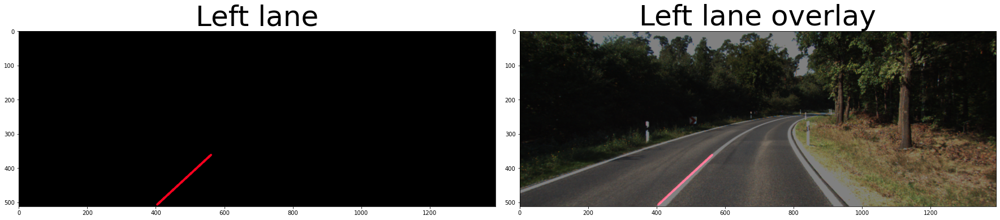

In [34]:
left_lane_single=final_lane_line(left=True)
print(left_lane_single)
final_left_lane=display_lines(undistorted_img,left_lane_single)

overlay_left = cv2.addWeighted(undistorted_img,0.5,final_left_lane,1,1)
plot_images(final_left_lane,overlay_left,'Left lane','Left lane overlay')

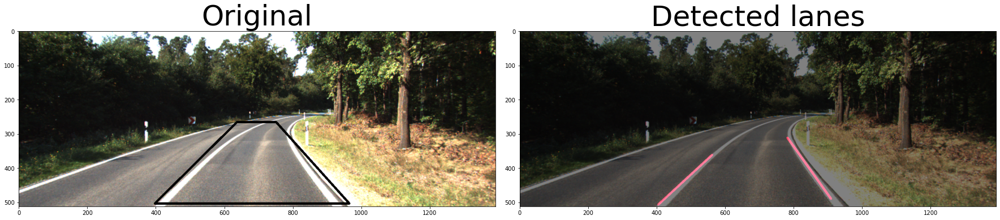

In [30]:
overlay_final = cv2.addWeighted(undistorted_img,0.5,final_right_lane+final_left_lane,1,1)
plot_images(img,overlay_final,'Original','Detected lanes')

In [31]:
def fill_detected_lane(img,poly):
    mask = np.zeros_like(img)
    match_mask_color = (0,0,255)
    cv2.fillPoly(mask,poly, match_mask_color)
    masked_image = cv2.bitwise_and(img, mask)
    return masked_image

In [35]:
lane_vertices=[(right_lane_single[0][0],right_lane_single[0][1]),(right_lane_single[0][2],right_lane_single[0][3]),(left_lane_single[0][0],left_lane_single[0][1]),(left_lane_single[0][2],left_lane_single[0][3])]
fillarea = fill_detected_lane(
    undistorted_img,
    np.array([lane_vertices], np.int32)
)
print(lane_vertices)

[(908, 489), (781, 311), (561, 361), (404, 506)]


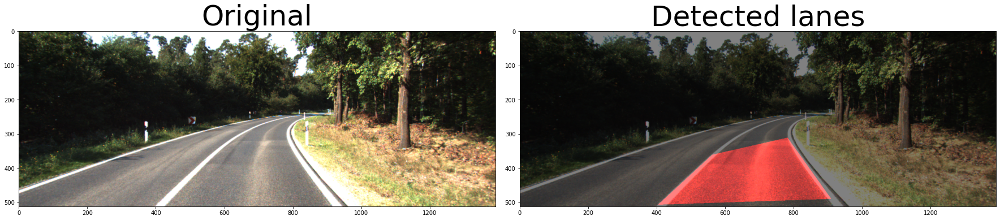

In [36]:
overlay_masked=cv2.addWeighted(undistorted_img,0.5,fillarea,1,1)
plot_images(undistorted_img,overlay_masked,'Original','Detected lanes')

#**Main Function**

CPU times: user 3 µs, sys: 0 ns, total: 3 µs
Wall time: 5.48 µs
[[926 502 851 391]]
[[592 356 400 511]]


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: RankWarning: Polyfit may be poorly conditioned
  app.launch_new_instance()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RankWarning: Polyfit may be poorly conditioned
  after removing the cwd from sys.path.


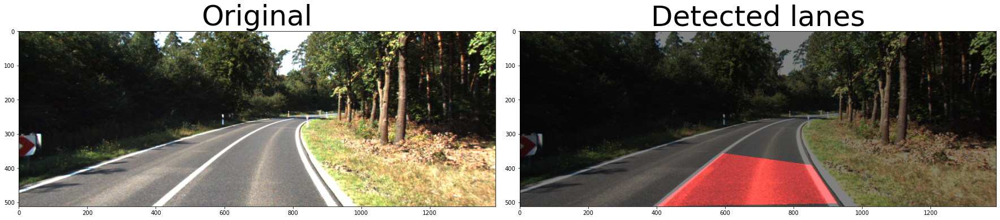

In [50]:
%time
img=cv2.imread(files[10])
undistorted_img=undistort(img)# Undistorted
points=region_of_interest()
canny=preprocess(undistorted_img)
#plot_images(undistorted_img,canny,'Original','Canny')
segment=bounding_box_masking(points,canny)
#plot_images(canny, segment,'Canny edge', "Bounding Box Masking")
lines = hough_lines(segment,100,30)
right_lane,left_lane=left_and_right(points,lines)
if len(right_lane)==0:
  print("Can't detect right lane")
elif len(left_lane)==0:
  print("Can't detect left lane")
x_right,y_right,x_sorted_right,fit_equation_right=best_fitting(left=False)
x_left,y_left,x_sorted_left,fit_equation_left=best_fitting(left = True)
right_lane_single=final_lane_line(left=False)
print(right_lane_single)
final_right_lane=display_lines(undistorted_img,right_lane_single)
left_lane_single=final_lane_line(left=True)
print(left_lane_single)
final_left_lane=display_lines(undistorted_img,left_lane_single)
lane_vertices=[(right_lane_single[0][0],right_lane_single[0][1]),(right_lane_single[0][2],right_lane_single[0][3]),(left_lane_single[0][0],left_lane_single[0][1]),(left_lane_single[0][2],left_lane_single[0][3])]
fillarea = fill_detected_lane(
    undistorted_img,
    np.array([lane_vertices], np.int32)
)
overlay_masked=cv2.addWeighted(undistorted_img,0.5,fillarea,1,1)
plot_images(undistorted_img,overlay_masked,'Original','Detected lanes')
# overlay_final = cv2.addWeighted(undistorted_img,0.5,final_right_lane+final_left_lane,1,1)
# plot_images(img,overlay_final,'Original','Detected lanes')

In [51]:
def detect_lanes(img,name=None):
  undistorted_img=undistort(img)# Undistorted
  points=region_of_interest()
  canny=preprocess(undistorted_img)
  #plot_images(undistorted_img,canny,'Original','Canny')
  segment=bounding_box_masking(points,canny)
  #plot_images(canny, segment,'Canny edge', "Bounding Box Masking")
  lines = hough_lines(segment,100,30)
  right_lane,left_lane=left_and_right(points,lines)
  if len(right_lane)==0:
    return "Can't detect right lane"
  elif len(left_lane)==0:
    return "Can't detect left lane"
  x_right,y_right,x_sorted_right,fit_equation_right=best_fitting(left=False)
  #print(x_right,y_right,x_sorted_right,fit_equation_right)
  x_left,y_left,x_sorted_left,fit_equation_left=best_fitting(left = True)
  #print(x_left,y_left,x_sorted_left,fit_equation_left)
  right_lane_single=final_lane_line(left=False)
  #print(right_lane_single)
  final_right_lane=display_lines(undistorted_img,right_lane_single)
  left_lane_single=final_lane_line(True)
  final_left_lane=display_lines(undistorted_img,left_lane_single)
  #print(left_lane_single)
  lane_vertices=[(right_lane_single[0][0],right_lane_single[0][1]),(right_lane_single[0][2],right_lane_single[0][3]),(left_lane_single[0][0],left_lane_single[0][1]),(left_lane_single[0][2],left_lane_single[0][3])]
  fillarea = fill_detected_lane(
    undistorted_img,
    np.array([lane_vertices], np.int32)
  )
  overlay_masked=cv2.addWeighted(undistorted_img,0.5,fillarea,1,1)

#  overlay_final = cv2.addWeighted(undistorted_img,0.5,final_right_lane+final_left_lane,1,1)
#   cv2.imwrite(name,overlay_final)
  plot_images(img,overlay_masked,'Original','Detected lanes')


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: RankWarning: Polyfit may be poorly conditioned
  app.launch_new_instance()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RankWarning: Polyfit may be poorly conditioned
  after removing the cwd from sys.path.


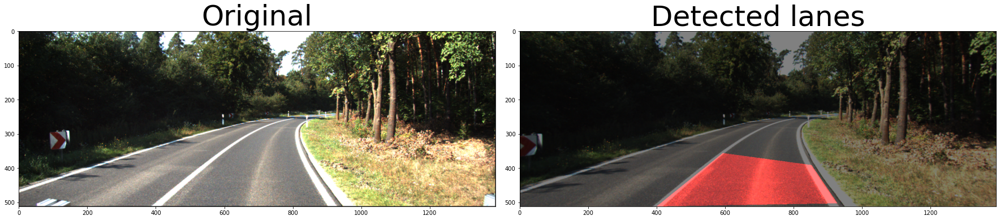

In [52]:
img=cv2.imread(files[10])
detect_lanes(img,name="test.jpg")

In [40]:
os.chdir("/content/output1")

FileNotFoundError: ignored

170


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: RankWarning: Polyfit may be poorly conditioned
  app.launch_new_instance()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RankWarning: Polyfit may be poorly conditioned
  after removing the cwd from sys.path.


171


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: RankWarning: Polyfit may be poorly conditioned
  app.launch_new_instance()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RankWarning: Polyfit may be poorly conditioned
  after removing the cwd from sys.path.


172


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: RankWarning: Polyfit may be poorly conditioned
  app.launch_new_instance()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RankWarning: Polyfit may be poorly conditioned
  after removing the cwd from sys.path.


173


/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:16: RankWarning: Polyfit may be poorly conditioned
  app.launch_new_instance()
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: RankWarning: Polyfit may be poorly conditioned
  after removing the cwd from sys.path.


174


KeyboardInterrupt: ignored

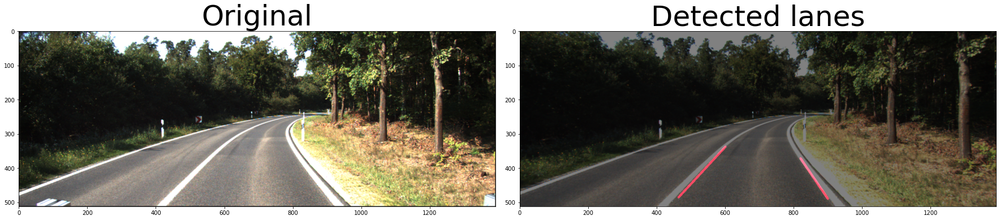

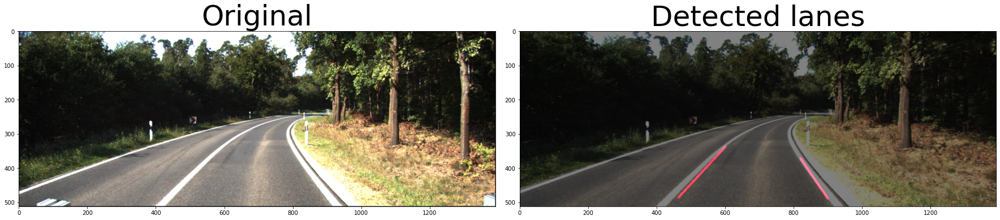

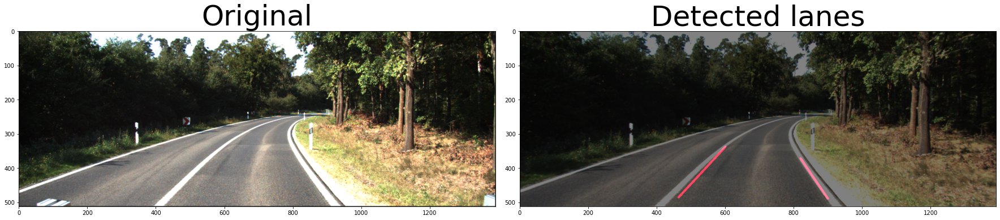

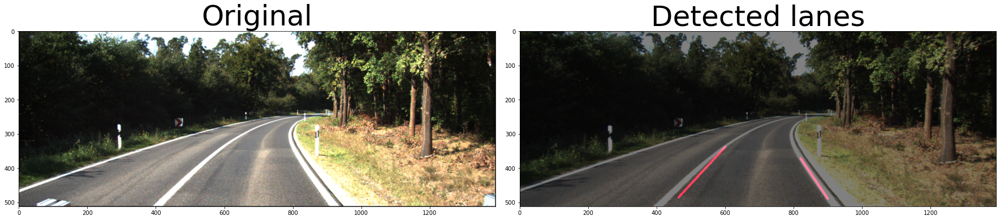

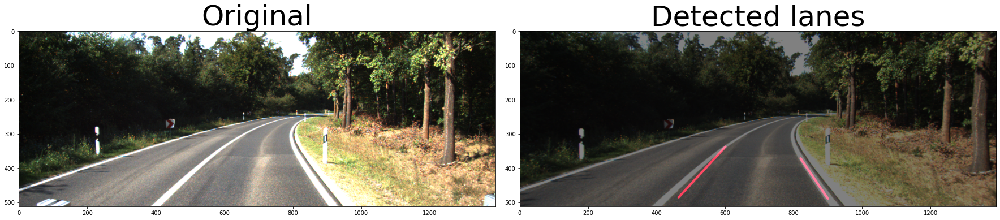

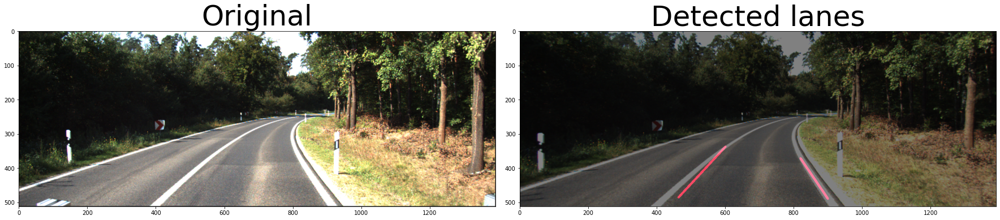

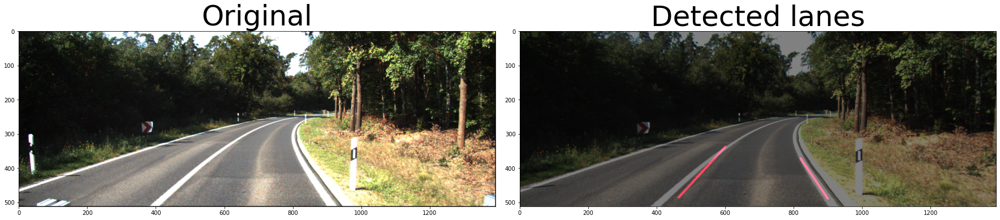

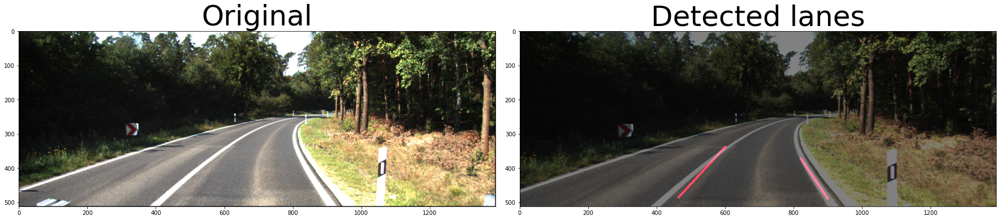

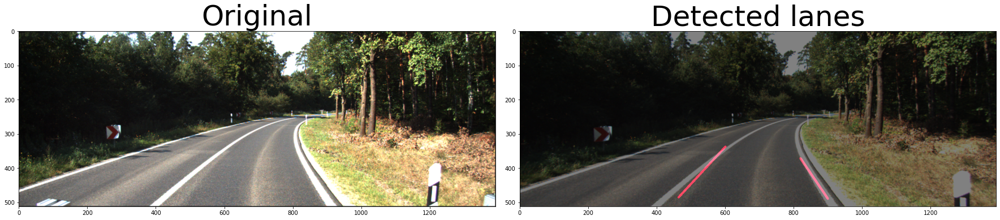

Error in callback <function flush_figures at 0x7f1f5cbce440> (for post_execute):


KeyboardInterrupt: ignored

In [43]:
counter = 0
for i in files:
    img = cv2.imread(i)
    name = i.split("/")[6]
    detect_lanes(img,name)
    print(counter)
    counter+=1

In [ ]:
!zip -r /content/output1.zip /content/output1

In [ ]:
from google.colab import files
files.download("/content/output1.zip")

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
counter = 0
start_time = time.perf_counter()
for i in files:
    img = cv2.imread(i)
    name = i.split("/")[6]
    img=cv2.imread(i)
    undistorted_img=undistort(img)# Undistorted
    points=region_of_interest()
    canny=preprocess(undistorted_img)
    #plot_images(undistorted_img,canny,'Original','Canny')
    segment=bounding_box_masking(points,canny)
    #plot_images(canny, segment,'Canny edge', "Bounding Box Masking")
    lines = hough_lines(segment,100,30)
    try:
        if len(lines) == 0:
            continue
    except:
        continue
    right_lane,left_lane=left_and_right(points,lines)
    if len(right_lane)==0:
        print("Can't detect right lane")
        continue
    elif len(left_lane)==0:
        print("Can't detect left lane")
        continue
    x_right,y_right,x_sorted_right,fit_equation_right=best_fitting(left=False)
    x_left,y_left,x_sorted_left,fit_equation_left=best_fitting(left = True)
    right_lane_single=final_lane_line(left=False)
    print(right_lane_single)
    final_right_lane=display_lines(undistorted_img,right_lane_single)
    left_lane_single=final_lane_line(left=True)
    print(left_lane_single)
    final_left_lane=display_lines(undistorted_img,left_lane_single)

    overlay_final = cv2.addWeighted(undistorted_img,0.5,final_right_lane+final_left_lane,1,1)
    # cv2.imwrite(name,overlay_final)
    # plot_images(img1,overlay_final,'Original','Detected lanes')
    print(counter)
    counter+=1
total_time = time.perf_counter() - start_time
avg_time = total_time/counter

In [ ]:
avg_time